In [ ]:
# Install necessary packages
%pip install --quiet --upgrade diffusers transformers accelerate invisible_watermark mediapy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.2/8.2 MB 102.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.7/265.7 kB 32.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 87.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 83.3 MB/s eta 0:00:00


In [ ]:
# Flag to determine whether to use the refiner model
use_refiner = True

In [ ]:
# Import required libraries
import torch
import mediapy as media
import random
import sys

# Import the DiffusionPipeline from diffusers
from diffusers import DiffusionPipeline
from diffusers import AutoPipelineForText2Image

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
# Initialize the DiffusionPipeline with a pre-trained base model
pipe = DiffusionPipeline.from_pretrained(
    "stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True,
    variant="fp16",
)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
# Check if using refiner
if use_refiner:
    # Initialize a DiffusionPipeline with a pre-trained refiner model
    refiner = DiffusionPipeline.from_pretrained(
        "stable-diffusion-xl-refiner-1.0",
        text_encoder_2=pipe.text_encoder_2,
        vae=pipe.vae,
        torch_dtype=torch.float16,
        use_safetensors=True,
        variant="fp16",
    )

    # Move the refiner model to CUDA (GPU)
    refiner = refiner.to("cuda")

    # Enable model CPU offload for the base pipeline
    pipe.enable_model_cpu_offload()
else:
    # Move the base pipeline to CUDA (GPU)
    pipe = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	an outdoor sculpture of a head using discarded car parts, highlighting it's beauty, highly detailed, 8k
Seed:	7453493079704115828


""

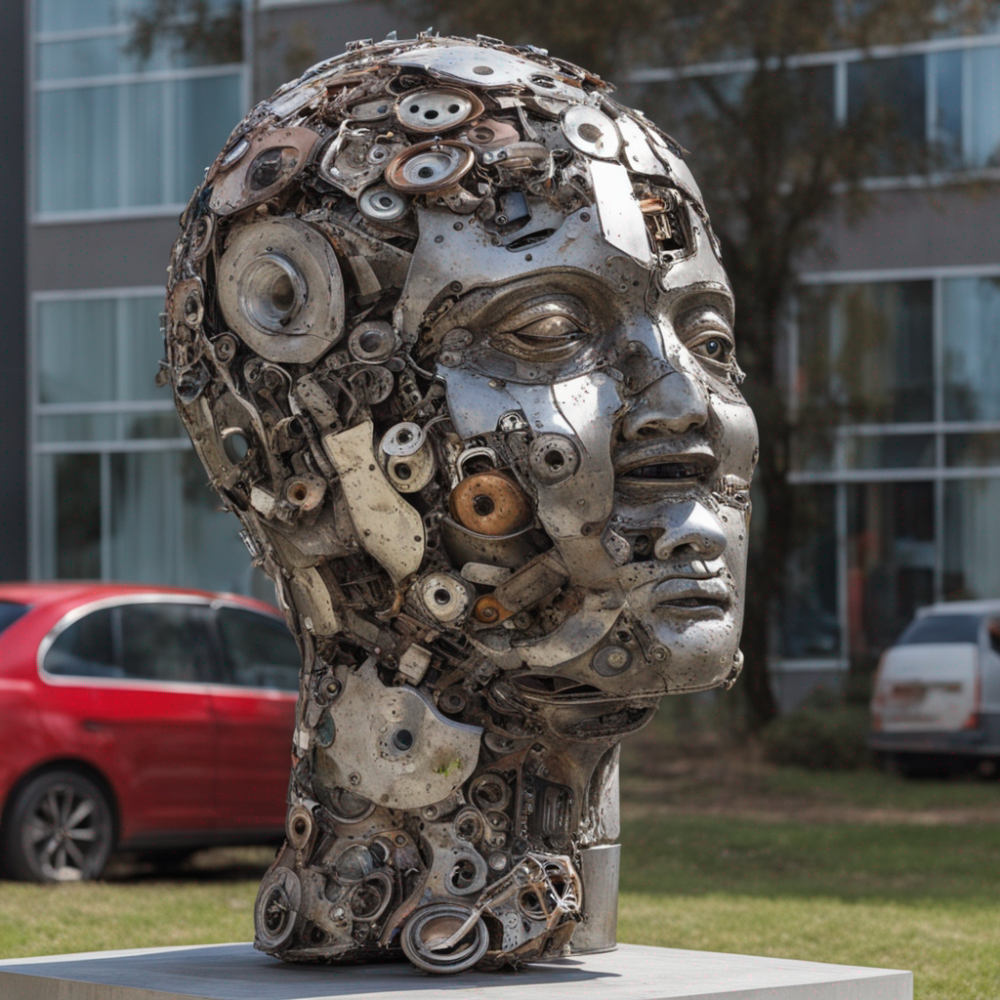

In [ ]:
# Specify a prompt for image generation
prompt = "an outdoor sculpture of a head using discarded car parts, highlighting it's beauty, highly detailed, 8k"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")


Token indices sequence length is longer than the specified maximum sequence length for this model (90 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in simon stalenhag michal karcz ismail inceoglu']
Token indices sequence length is longer than the specified maximum sequence length for this model (90 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in simon stalenhag michal karcz ismail inceoglu']


  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (90 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['in simon stalenhag michal karcz ismail inceoglu']


  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	abstract colors, texture, film grain:0. 1 intricate close up dramatic portrait of a (cyberpunk)1. 2 porsche standing on a rainy bustling crowded cyberpunk city street, ultra realistic texture, foggy morning, cinematic movie still frame, gtr, altered carbon, (analog style)1. 3 (film grain)1. 3, stephan martiniere Wadim Kashin Simon Stalenhag michal karcz ismail inceoglu
Seed:	7904308419651739370


""

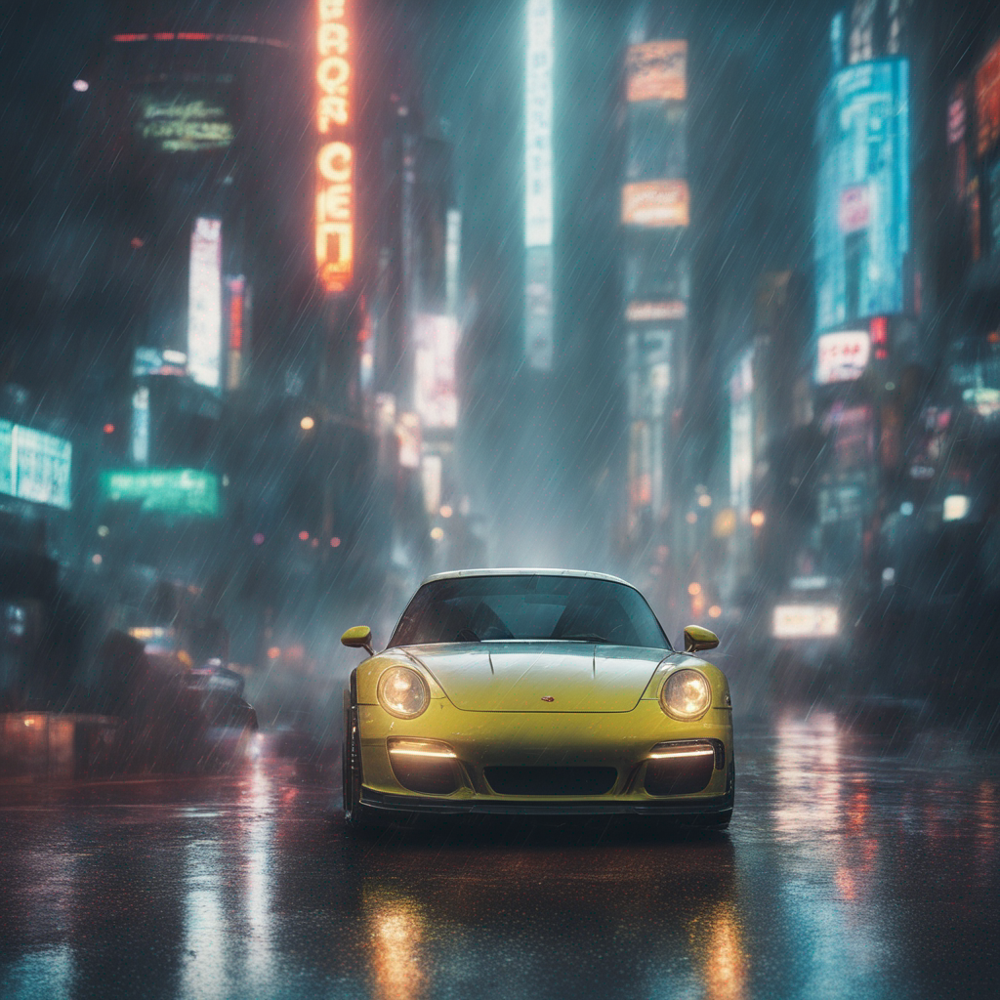

In [ ]:
# Specify a prompt for image generation
prompt = "abstract colors, texture, film grain:0. 1 intricate close up dramatic portrait of a (cyberpunk)1. 2 porsche standing on a rainy bustling crowded cyberpunk city street, ultra realistic texture, foggy morning, cinematic movie still frame, gtr, altered carbon, (analog style)1. 3 (film grain)1. 3, stephan martiniere Wadim Kashin Simon Stalenhag michal karcz ismail inceoglu"
# prompt = "an outdoor sculpture of a head using discarded car parts, highlighting it's beauty, highly detailed, 8k"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	An astronaut exploring a neon-lit alien marketplace, filled with various extraterrestrial species trading exotic goods, under a sky with three moons
Seed:	2919359273300101254


""

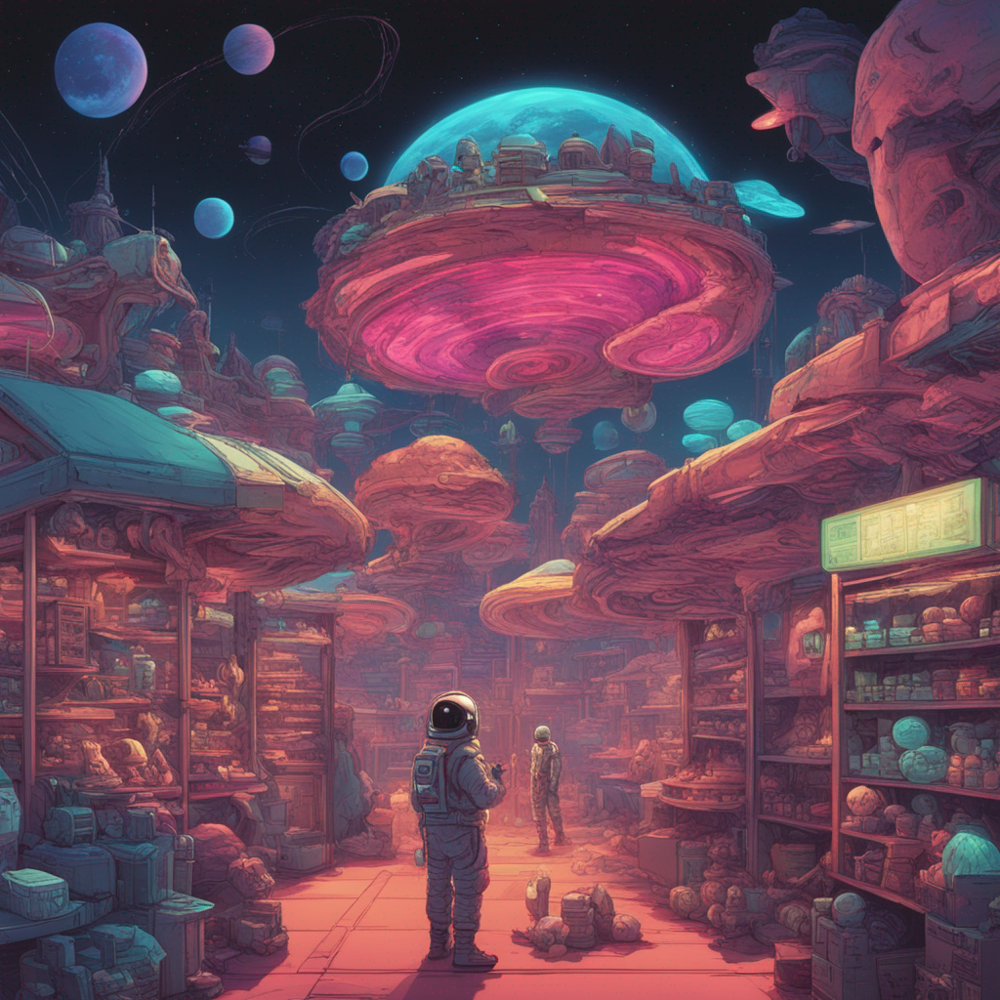

In [ ]:
# Specify a prompt for image generation
prompt = "An astronaut exploring a neon-lit alien marketplace, filled with various extraterrestrial species trading exotic goods, under a sky with three moons"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	A whimsical forest with trees that have leaves of shimmering crystal, bioluminescent mushrooms dotting the path, and friendly forest creatures with glowing eyes
Seed:	406626310528733901


""

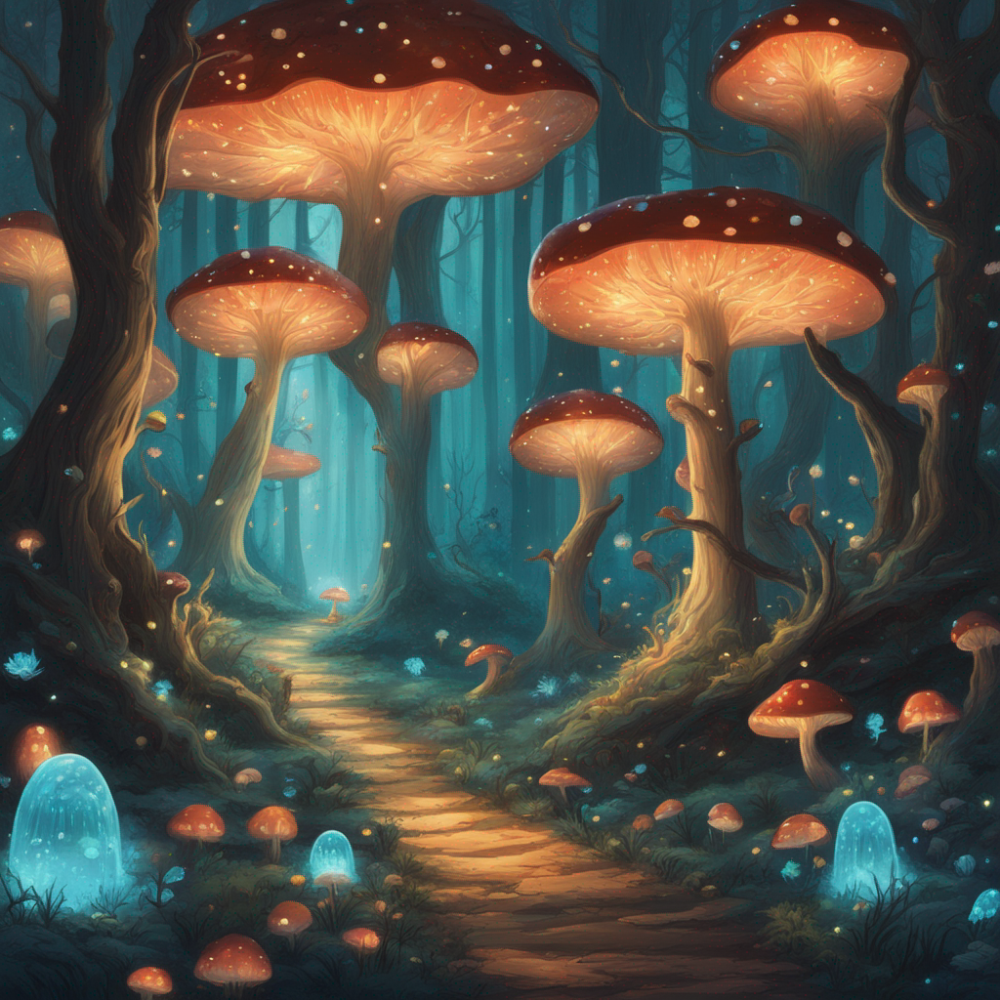

In [ ]:
# Specify a prompt for image generation
prompt = "A whimsical forest with trees that have leaves of shimmering crystal, bioluminescent mushrooms dotting the path, and friendly forest creatures with glowing eyes"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	A grand medieval banquet in a castle hall, with lords and ladies in elaborate attire feasting at a table laden with exotic dishes, as minstrels play in the background
Seed:	5935169223073035118


""

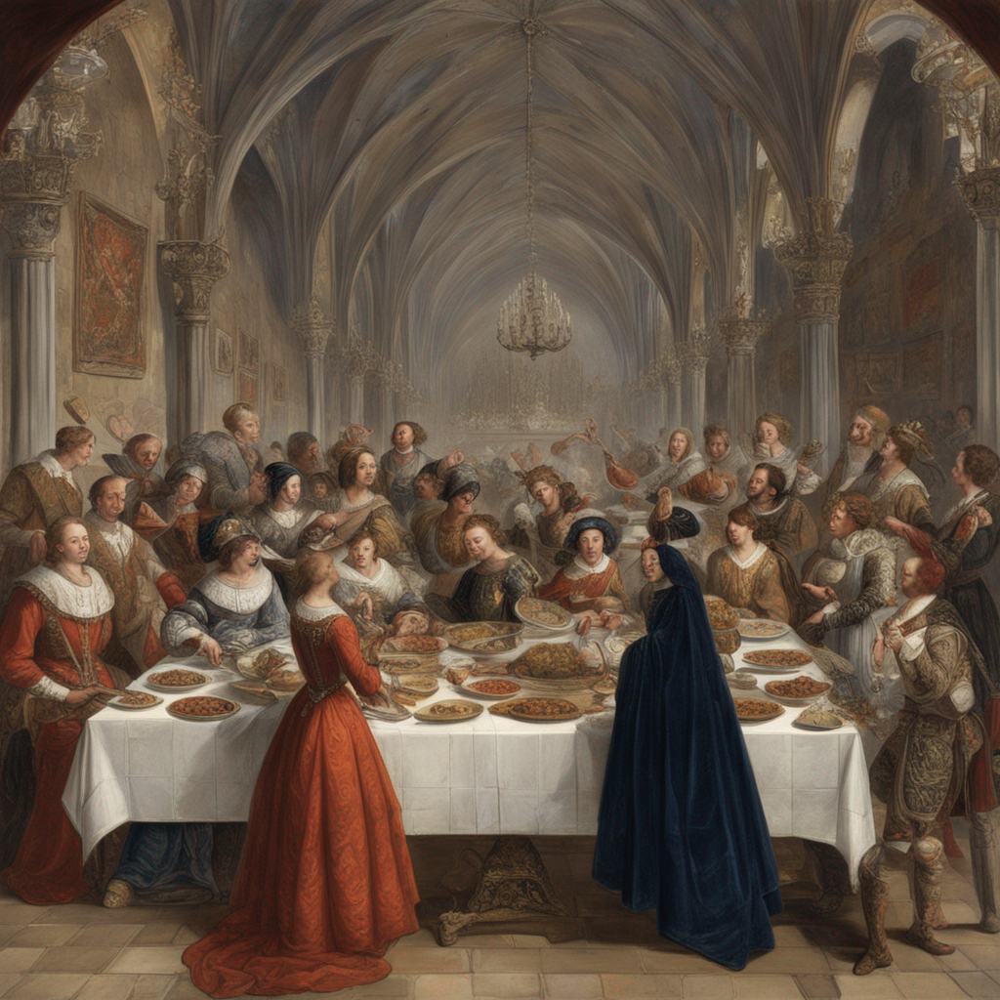

In [ ]:
# Specify a prompt for image generation
prompt = "A grand medieval banquet in a castle hall, with lords and ladies in elaborate attire feasting at a table laden with exotic dishes, as minstrels play in the background"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	An underwater city with coral buildings, merpeople swimming through the streets, fish-like vehicles, and a grand palace made of pearl and seashell
Seed:	7593350776796492615


""

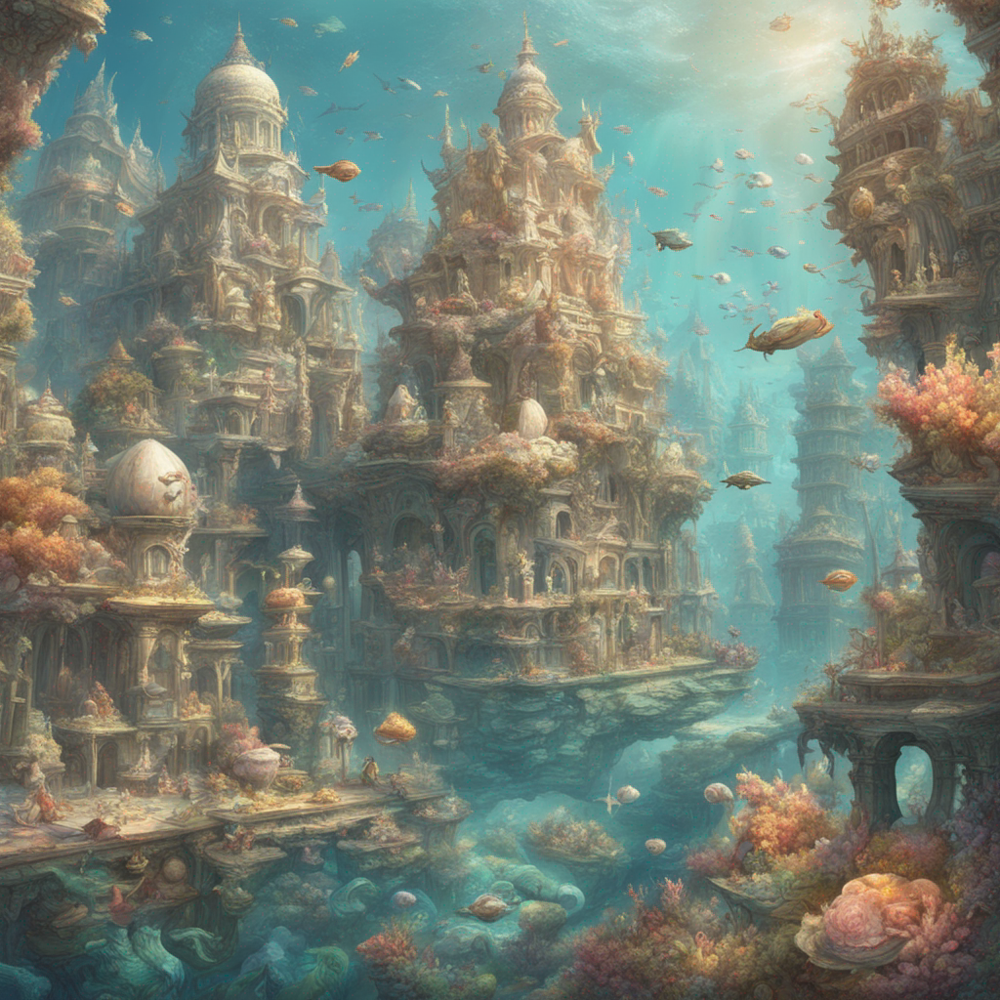

In [ ]:
# Specify a prompt for image generation
prompt = "An underwater city with coral buildings, merpeople swimming through the streets, fish-like vehicles, and a grand palace made of pearl and seashell"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	A post-apocalyptic cityscape where nature has reclaimed the ruins, with overgrown buildings, a river running through the main street, and survivors foraging for resources
Seed:	8379981824767301684


""

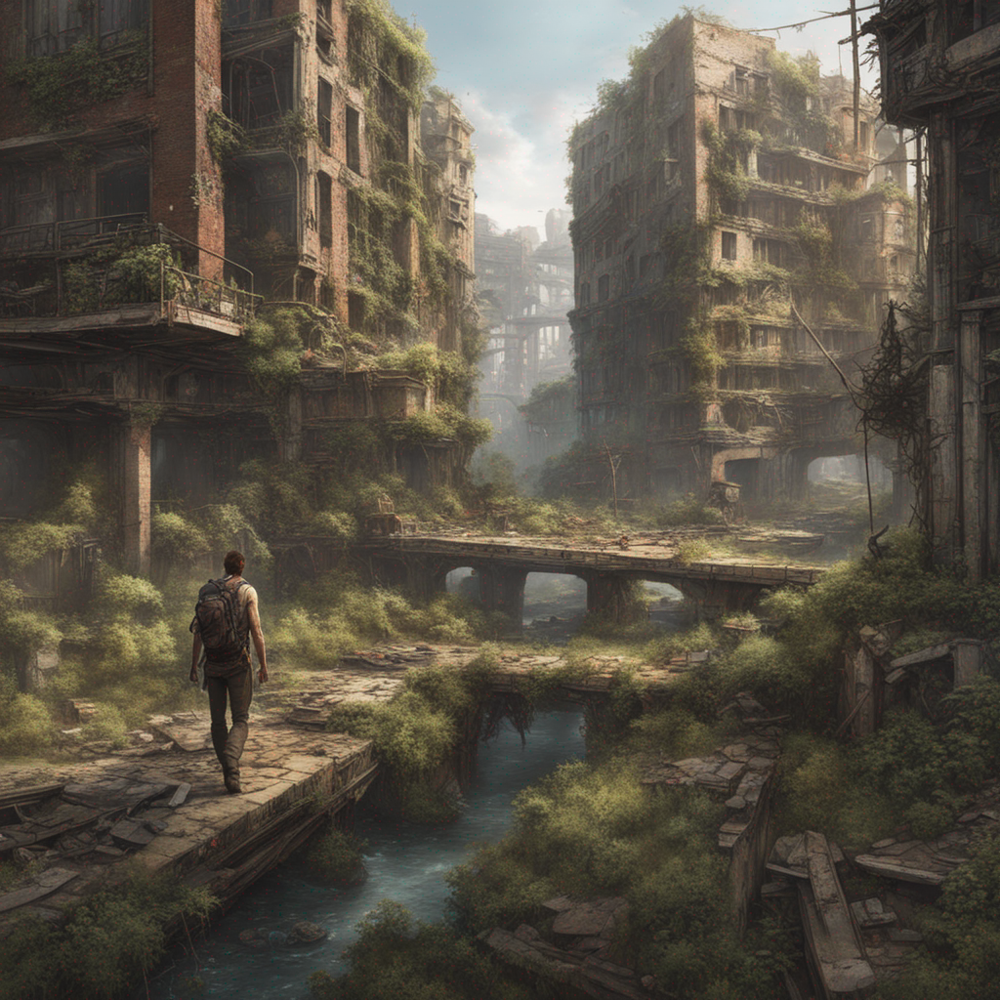

In [ ]:
# Specify a prompt for image generation
prompt = "A post-apocalyptic cityscape where nature has reclaimed the ruins, with overgrown buildings, a river running through the main street, and survivors foraging for resources"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	A cyberpunk street scene at night, with neon signs in multiple languages, diverse crowds, flying vehicles overhead, and a noir detective observing from the shadows
Seed:	8789507227856596511


""

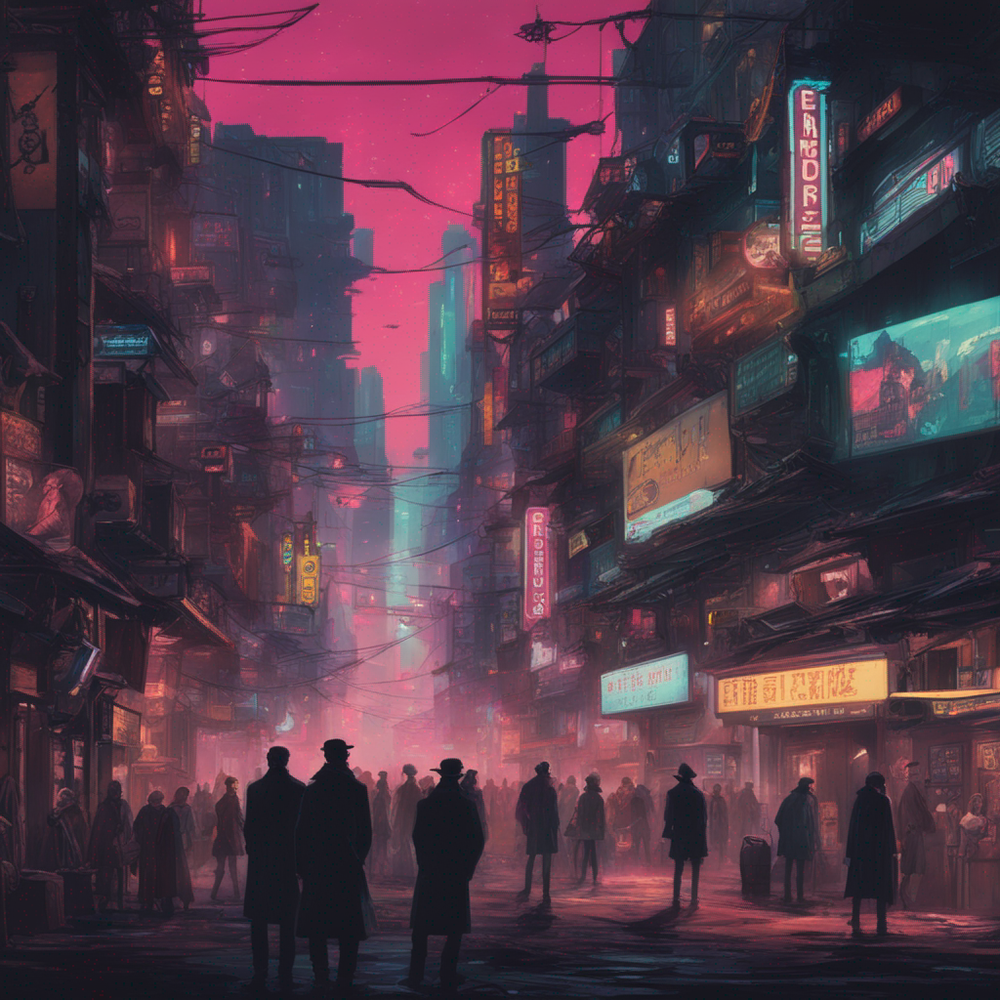

In [ ]:
# Specify a prompt for image generation
prompt = "A cyberpunk street scene at night, with neon signs in multiple languages, diverse crowds, flying vehicles overhead, and a noir detective observing from the shadows"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	A vast library in an ancient monastery, with towering shelves filled with ancient tomes, scrolls, and artifacts, and a secret passage hidden behind one of the bookcases
Seed:	1721083616512280931


""

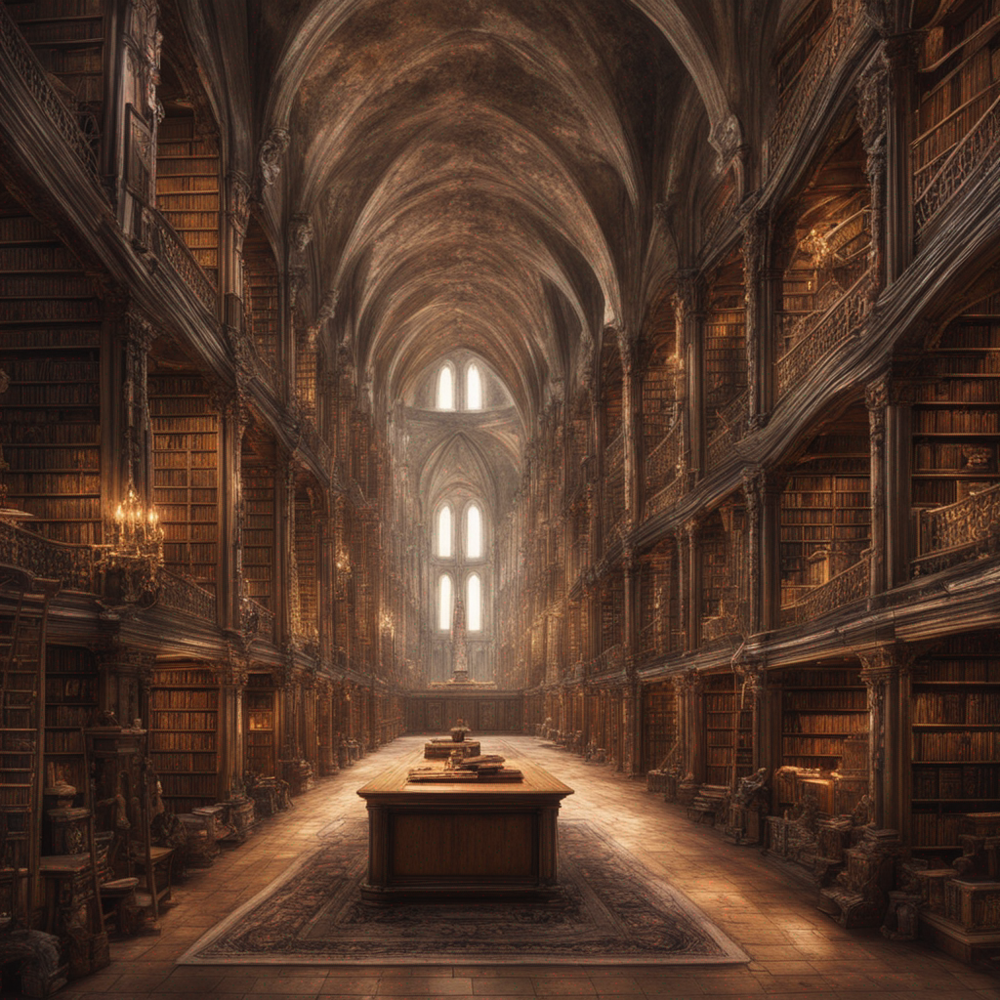

In [ ]:
# Specify a prompt for image generation
prompt = "A vast library in an ancient monastery, with towering shelves filled with ancient tomes, scrolls, and artifacts, and a secret passage hidden behind one of the bookcases"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	A magical garden at midnight, with flowers that glow and change colors, fairies dancing around a moonlit pond, and a majestic unicorn resting under a willow tree
Seed:	4949422486088468905


""

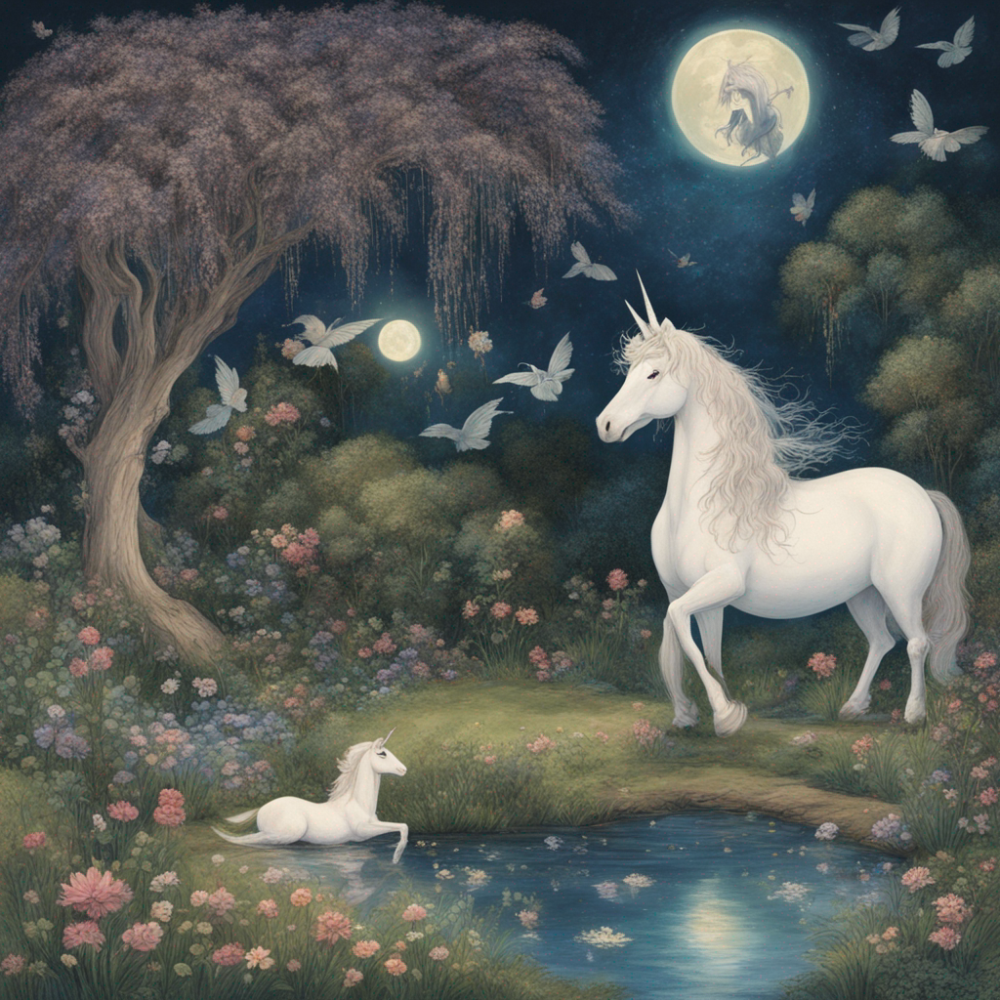

In [ ]:
# Specify a prompt for image generation
prompt = "A magical garden at midnight, with flowers that glow and change colors, fairies dancing around a moonlit pond, and a majestic unicorn resting under a willow tree"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

Prompt:	An epic space battle with sleek starships, exploding stars, and a massive space station, all set against the backdrop of a swirling galaxy
Seed:	4935240911233341690


""

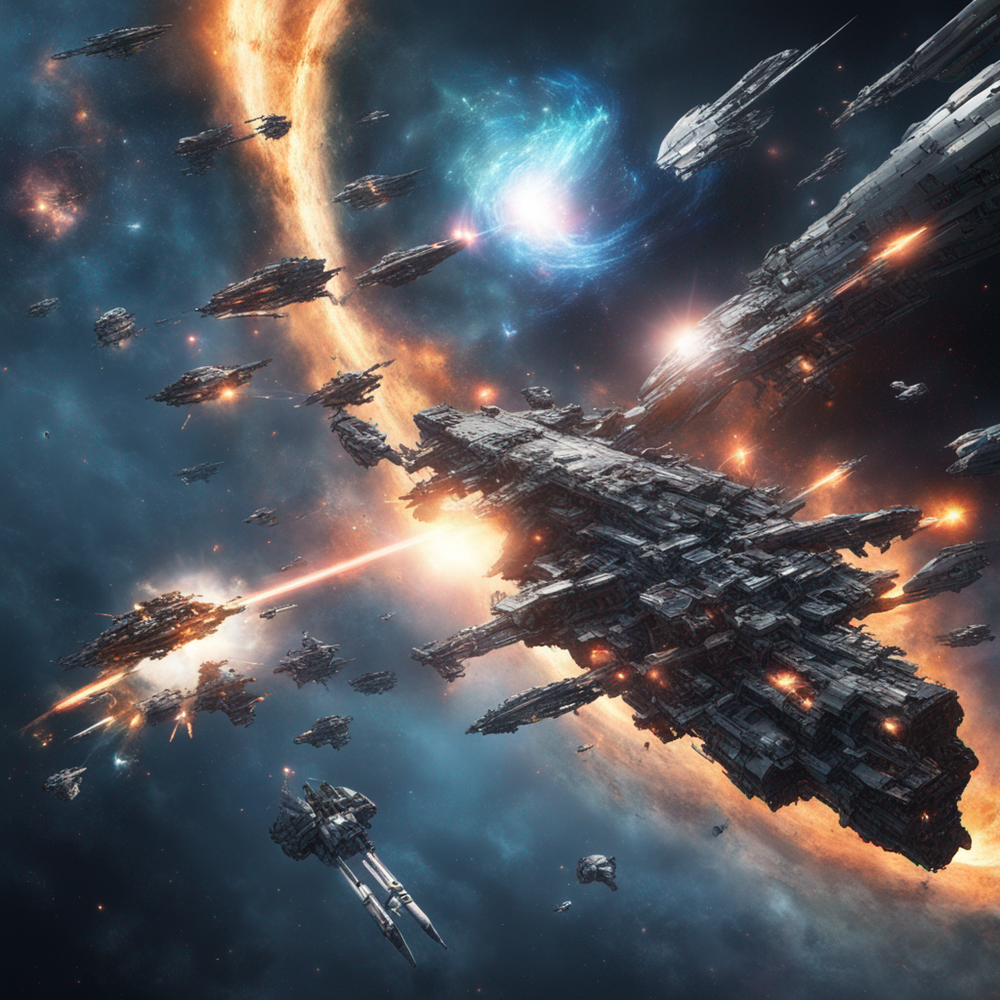

In [ ]:
# Specify a prompt for image generation
prompt = "An epic space battle with sleek starships, exploding stars, and a massive space station, all set against the backdrop of a swirling galaxy"
# Generate a random seed
seed = random.randint(0, sys.maxsize)

# Use the pipeline to generate images based on the prompt
images = pipe(
    prompt=prompt,
    output_type="latent" if use_refiner else "pil",
    generator=torch.Generator("cuda").manual_seed(seed),
).images

# If using the refiner, refine the images
if use_refiner:
    images = refiner(
        prompt=prompt,
        image=images,
    ).images

# Print the prompt and seed
print(f"Prompt:\t{prompt}\nSeed:\t{seed}")

# Display the generated images
media.show_images(images)

# Save the first image as "output.jpg"
images[0].save("output.jpg")

In [ ]:
!nvidia-smi

Fri Jan  5 22:51:15 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   71C    P0              32W /  70W |  11331MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--